# Image Clustering & Semantic Search

## Data Source: Artwork Images of Vincent van Gogh

### Step1: Image Classification 

In [ ]:
pip install sentence_transformers

In [ ]:
conda install freetype=2.10.4 

In [15]:
from sentence_transformers import SentenceTransformer, util
from PIL import Image
import glob
import torch
import pickle
import zipfile
from IPython.display import display
from IPython.display import Image as IPImage
import os
from tqdm.autonotebook import tqdm

# load the respective CLIP model
model = SentenceTransformer('clip-ViT-B-32')

In [16]:
# get 1100+ VanGogh images
# the kernel died several times so we test with a smaller dataset of 500 images;
from PIL import ImageFile
# ignore truncated and compressed images; 
ImageFile.LOAD_TRUNCATED_IMAGES = True
import glob

img_folder = '/VanGogh_test'
img_dir = '/Users/eeeffy/Desktop/Effy汇总/Digital Humanity学习/Thesis:Intern/images/VanGogh_test'# add image dir
# the image file includes jpg and jpeg format; 
img_paths = glob.glob(os.path.join(img_dir, '*.jpg')) + glob.glob(os.path.join(img_dir, '*.jpeg'))
img_names = [os.path.basename(path) for path in img_paths]
print("Images:", len(img_names))
img_emb = model.encode([Image.open(path) for path in img_paths], batch_size=128, convert_to_tensor=True, show_progress_bar=True)


Images: 500


Batches:   0%|          | 0/4 [00:00<?, ?it/s]

In [17]:
img_emb.shape

torch.Size([500, 512])

In [ ]:
# function to detect clusters from images;
# since the dataset is small, I set min-size of 3, max-size of 500;
def community_detection(embeddings, threshold, min_community_size=3, init_max_size=500):
    """
    Function for Fast Community Detection

    Finds in the embeddings all communities, i.e. embeddings that are close (closer than threshold).

    Returns only communities that are larger than min_community_size. The communities are returned
    in decreasing order. The first element in each list is the central point in the community.
    """

    # Compute cosine similarity scores
    cos_scores = util.cos_sim(embeddings, embeddings)

    # Minimum size for a community
    top_k_values, _ = cos_scores.topk(k=min_community_size, largest=True)

    # Filter for rows >= min_threshold
    extracted_communities = []
    for i in range(len(top_k_values)):
        if top_k_values[i][-1] >= threshold:
            new_cluster = []

            # Only check top k most similar entries
            top_val_large, top_idx_large = cos_scores[i].topk(k=init_max_size, largest=True)
            top_idx_large = top_idx_large.tolist()
            top_val_large = top_val_large.tolist()

            if top_val_large[-1] < threshold:
                for idx, val in zip(top_idx_large, top_val_large):
                    if val < threshold:
                        break

                    new_cluster.append(idx)
            else:
                # Iterate over all entries (slow)
                for idx, val in enumerate(cos_scores[i].tolist()):
                    if val >= threshold:
                        new_cluster.append(idx)
            extracted_communities.append(new_cluster)

    # Largest cluster first
    extracted_communities = sorted(extracted_communities, key=lambda x: len(x), reverse=True)

    # Step 2) Remove overlapping communities
    unique_communities = []
    extracted_ids = set()

    for community in extracted_communities:
        add_cluster = True
        for idx in community:
            if idx in extracted_ids:
                add_cluster = False
                break

        if add_cluster:
            unique_communities.append(community)
            for idx in community:
                extracted_ids.add(idx)

    return unique_communities

In [18]:
# run the clustering algorithm
# I set the minimal size of images in a cluster to be 3
clusters = community_detection(img_emb, threshold=0.9, min_community_size=3)
# display the amount of clusters;
print("Total number of clusters:", len(clusters))

Total number of clusters: 18




Cluster size: 16


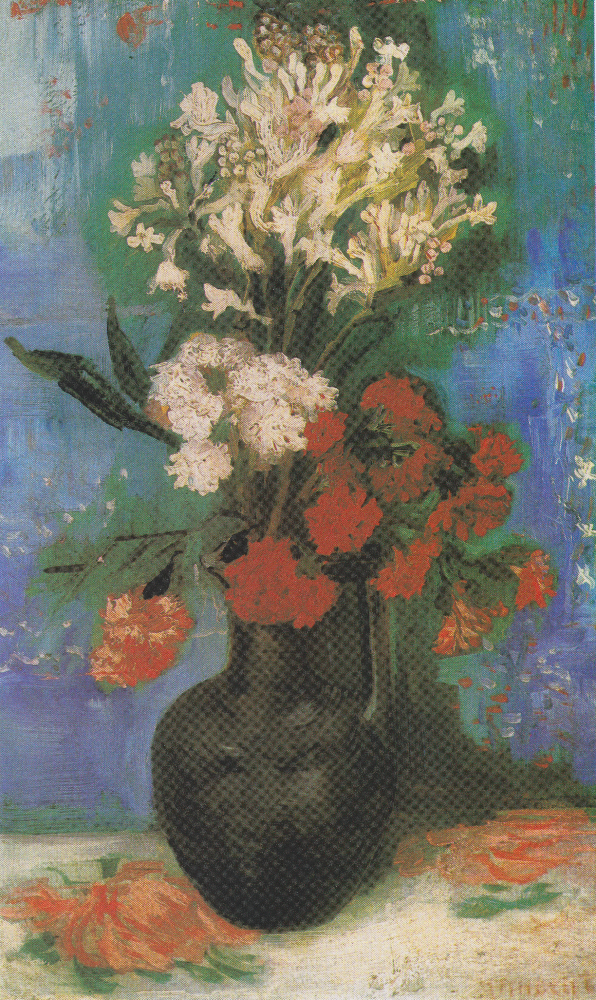

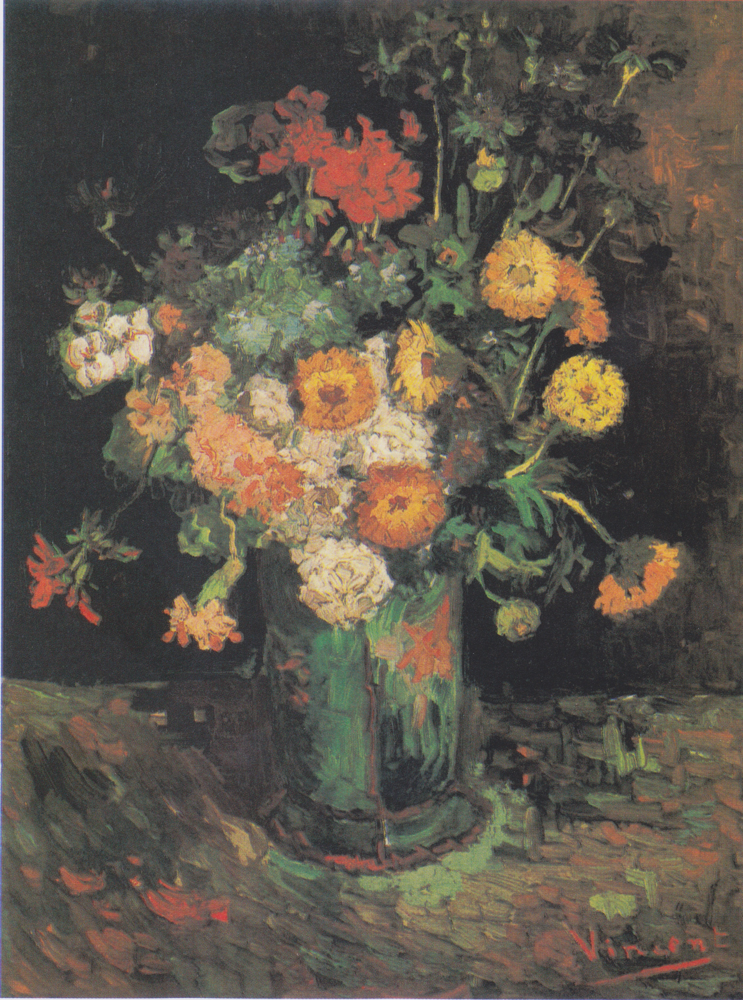



Cluster size: 13


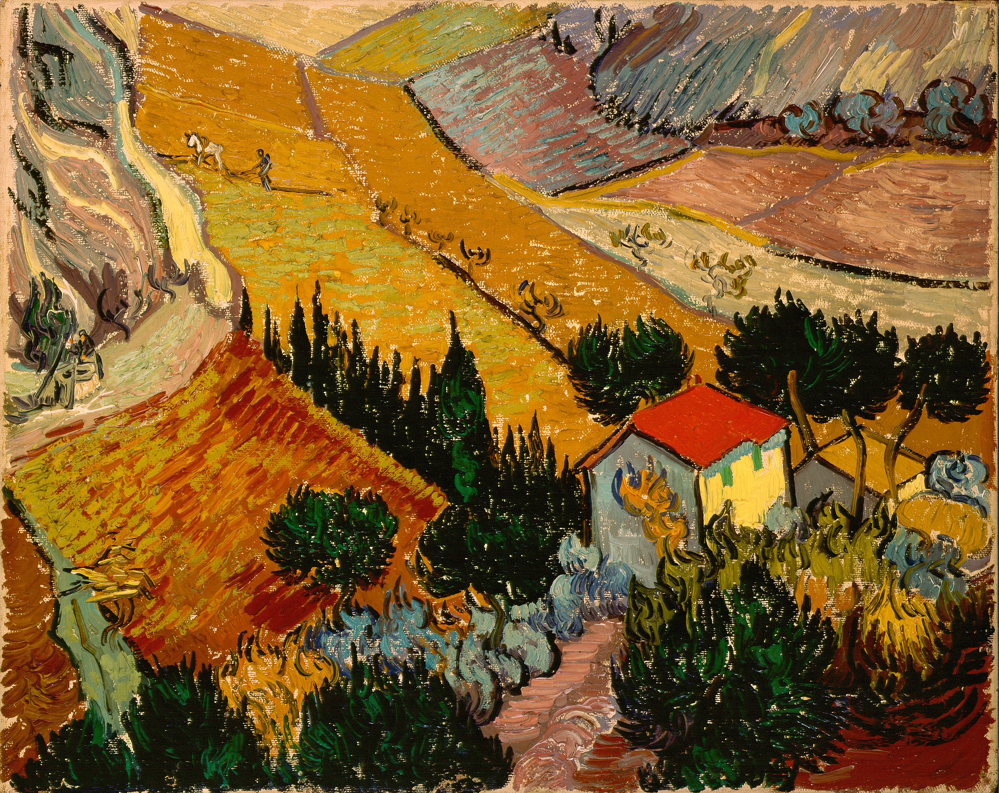

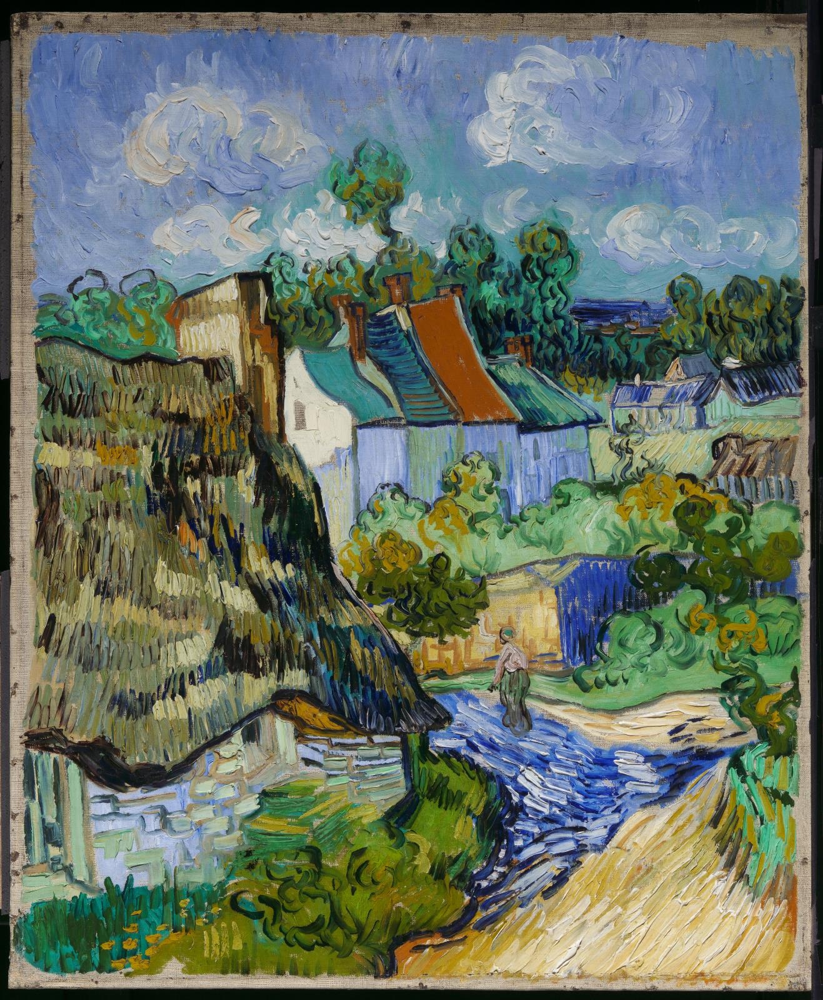

In [27]:
# show the Top3 largest clusters
for cluster in clusters[0:2]:
    print("\n\nCluster size:", len(cluster))
    
    # Output 2 images in the clusters;
    for idx in cluster[0:2]:
        display(IPImage(os.path.join(img_dir, img_names[idx]), width=200))

### STEP2: Semantic Search

In [22]:
# load a multilingual CLIP model to encode text into CLIP embedding
model_multi = SentenceTransformer('clip-ViT-B-32-multilingual-v1')

In [ ]:
k =3

In [ ]:
query_emb = model_multi.encode(["flower"], convert_to_tensor=True, show_progress_bar=False)
hits = util.semantic_search(query_emb, img_emb, top_k=k)[0]

In [23]:
# define a search function.
def search(query, k):
    # encode the query (which can either be an image or a text string)
    query_emb = model_multi.encode([query], convert_to_tensor=True, show_progress_bar=False)
    
    # Then, we use the util.semantic_search function, which computes the cosine-similarity
    # between the query embedding and all image embeddings.
    # It then returns the top_k highest ranked images, which we output
    hits = util.semantic_search(query_emb, img_emb, top_k=k)[0]
    
    print("Query:")
    display(query)
    for hit in hits:
        print(img_names[hit['corpus_id']])
        display(IPImage(os.path.join(img_dir, img_names[hit['corpus_id']]), width=200))

Query:


'blue'

Portrait_of_Adeline_Ravoux,_by_Vincent_van_Gogh.jpg


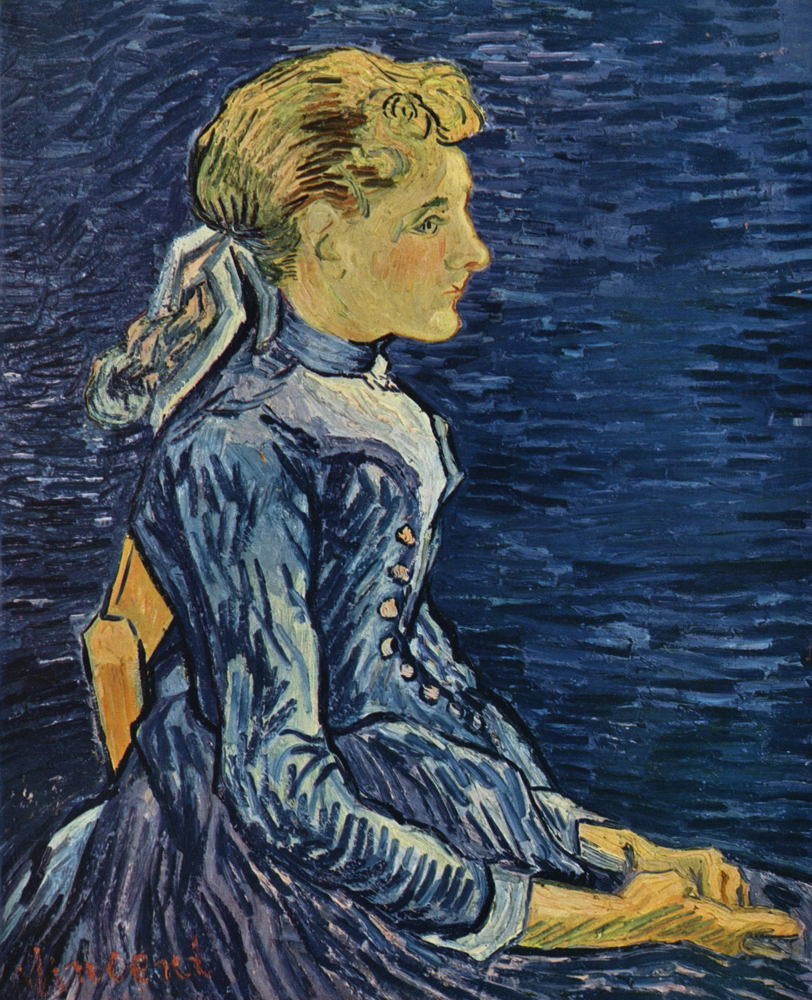

Van_Gogh_-_Bildnis_Adeline_Ravoux2.jpeg


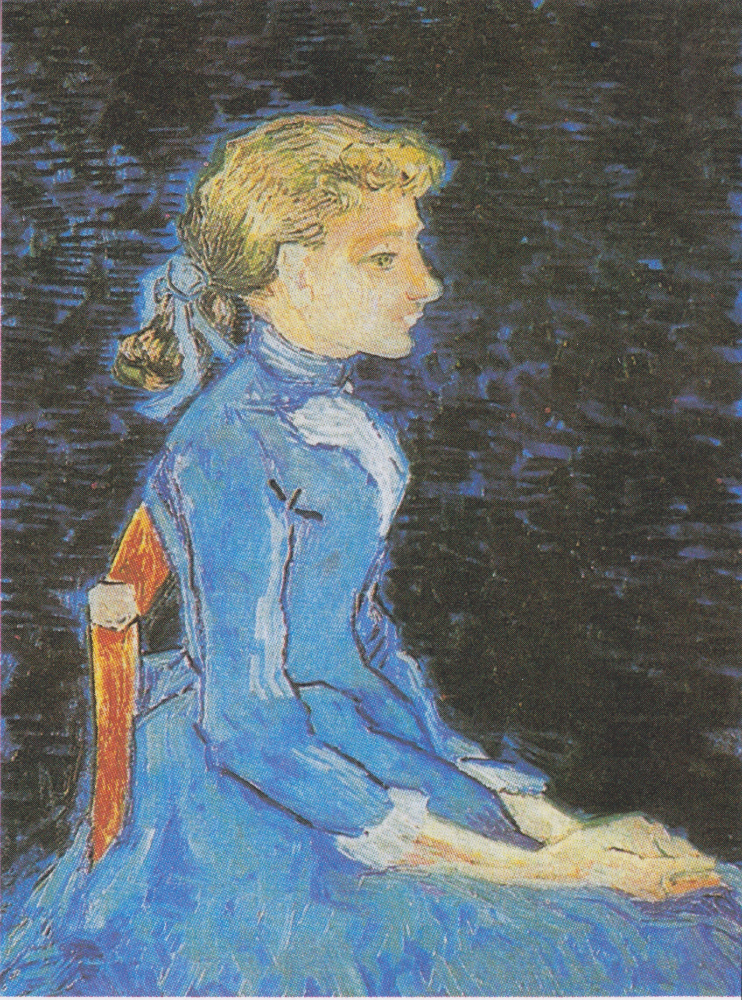

In [26]:
# search color 
search("blue", k = 2)

In [ ]:
# search items in the images;
search("flower", k = 3)